=== Computing Homography referencing the new reference (full res) ===
=== Quick Crop Visualization ===
data/satellite/aqua/2012/20120828_AQUA.jpg => final size after date+common crop = (1200, 830)
data/satellite/aqua/2020/20200717_AQUA.jpg => final size after date+common crop = (1193, 830)
=== Loading Water Mask ===
=== Visualizing Intermediate Pipeline States With Water Mask Overlay ===


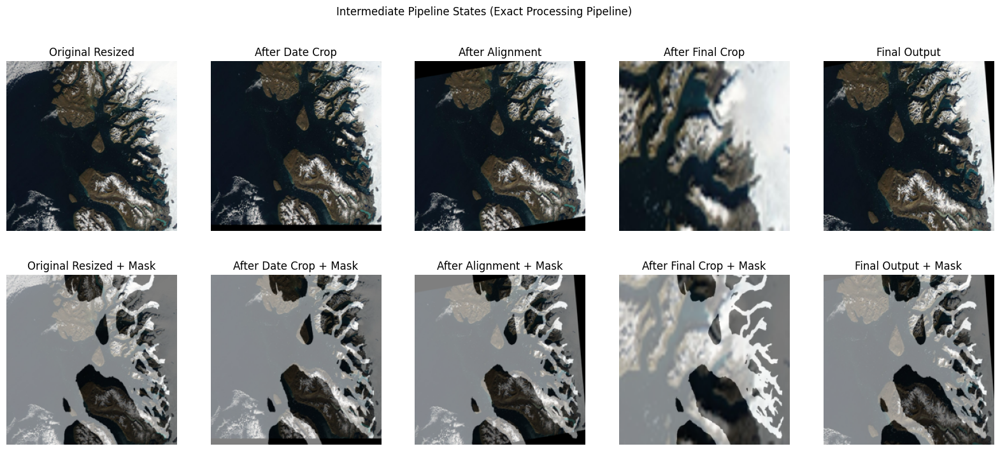

=== Building DataFrames from TRAIN_IN ===
=== Building TF Datasets (in memory pipeline) ===
=== Train Ice Model ===


2025-04-10 14:08:51.749373: I metal_plugin/src/device/metal_device.cc:1154] Metal device set to: Apple M3 Pro
2025-04-10 14:08:51.749405: I metal_plugin/src/device/metal_device.cc:296] systemMemory: 18.00 GB
2025-04-10 14:08:51.749410: I metal_plugin/src/device/metal_device.cc:313] maxCacheSize: 6.00 GB
I0000 00:00:1744286931.749421 18703013 pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
I0000 00:00:1744286931.749439 18703013 pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


Epoch 1/30


2025-04-10 14:09:04.000584: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:117] Plugin optimizer for device_type GPU is enabled.


21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.4976 - loss: 0.6869
Epoch 1: val_loss improved from inf to 0.66093, saving model to best_ice_model.keras
21/21 ━━━━━━━━━━━━━━━━━━━━ 128s 2s/step - accuracy: 0.5034 - loss: 0.6849 - val_accuracy: 0.5500 - val_loss: 0.6609
Epoch 2/30
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.7661 - loss: 0.5538
Epoch 2: val_loss did not improve from 0.66093
21/21 ━━━━━━━━━━━━━━━━━━━━ 46s 2s/step - accuracy: 0.7678 - loss: 0.5525 - val_accuracy: 0.5500 - val_loss: 0.6669
Epoch 3/30
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.8914 - loss: 0.4214
Epoch 3: val_loss did not improve from 0.66093
21/21 ━━━━━━━━━━━━━━━━━━━━ 45s 2s/step - accuracy: 0.8919 - loss: 0.4212 - val_accuracy: 0.5000 - val_loss: 0.7307
Epoch 4/30
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.8832 - loss: 0.3750
Epoch 4: val_loss improved from 0.66093 to 0.43797, saving model to best_ice_model.keras
21/21 ━━━━━━━━━━━━━━━━━━━━ 46s 2s/step - accuracy: 0.8832 - loss:

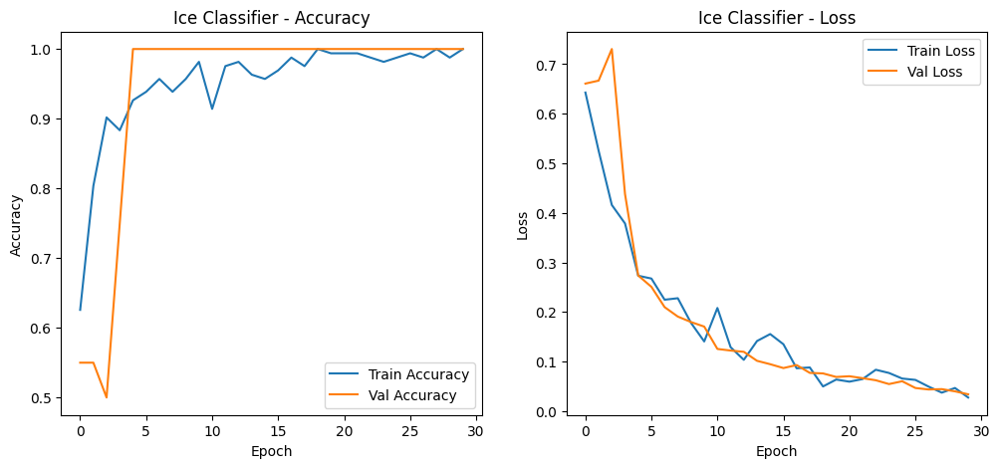

Evaluate Ice Model on test set:
3/3 ━━━━━━━━━━━━━━━━━━━━ 4s 2s/step - accuracy: 0.9293 - loss: 0.1051 
1/1 ━━━━━━━━━━━━━━━━━━━━ 13s 13s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 19s 19s/step
Confusion Matrix:
 [[ 8  0]
 [ 1 12]]
              precision    recall  f1-score   support

     sea_ice       0.89      1.00      0.94         8
      no_ice       1.00      0.92      0.96        13

    accuracy                           0.95        21
   macro avg       0.94      0.96      0.95        21
weighted avg       0.96      0.95      0.95        21

=== Inference on leftover images ===


2025-04-10 14:32:45.240805: I tensorflow/core/framework/local_rendezvous.cc:407] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


FileNotFoundError: [Errno 2] No such file or directory: 'data/leftover'

In [ ]:
#############################
# FULL PIPELINE WITH OFFLINE ALIGNMENT (OLD -> NEW GEOMETRY),
# FINAL CROPPING, & MASK OVERLAY – IN‐MEMORY PROCESSING
# Incorporates fixes so that:
#  - "After date-based crop" really happens first,
#  - Then alignment references the new reference at full resolution,
#  - Then the final bounding box is applied,
#  - Finally, we downsample to IMG_SIZE.
# PLUS, the pipeline stages are visualized exactly as processed.
#############################

import os
import re
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image
from datetime import datetime

import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from sklearn.metrics import confusion_matrix, classification_report

from tensorflow.keras.applications import EfficientNetV2S, ConvNeXtTiny
from tensorflow.keras.layers import GlobalAveragePooling2D, Dropout, Dense
from tensorflow.keras import Model

#############################
# 1) GLOBAL PARAMETERS
#############################
CUTOFF_NEW_FORMAT = datetime(2016, 6, 5)
# Final bounding box, applied AFTER alignment, to remove leftover edges.
# (Negative right/bottom indicate offsets from the image's right/bottom edge.)
FINAL_COMMON_BOX = (129, 47, -14, -122)
IMG_SIZE = (224, 224)  # Final model input resolution

# Reference image paths
OLD_REF_PATH = "data/satellite/aqua/2012/20120828_AQUA.jpg"  # Pre-2016
NEW_REF_PATH = "data/satellite/aqua/2020/20200717_AQUA.jpg"  # Post-2016

TRAIN_IN = "data/train"       # subfolders: sea_ice, no_ice, cloudy
LEFTOVER_DIR = "data/leftover"

#############################
# 2) CROPPING FUNCTIONS
#############################
def parse_date_from_filename(filename):
    """
    Extract YYYYMMDD from filename (e.g. 20120828_AQUA.jpg → datetime(2012,8,28)).
    """
    base = os.path.basename(filename)
    match = re.match(r'(\d{8})', base)
    if match:
        return datetime.strptime(match.group(1), '%Y%m%d')
    return None

def choose_date_crop_box(w, h, file_date):
    """
    If old (<2016-06-05): returns (0, 200, 1200, 1030);
    otherwise returns (110, 272, w-437, h-113).
    """
    if file_date is None:
        return None
    if file_date < CUTOFF_NEW_FORMAT:
        return (0, 200, 1200, 1030)
    else:
        left = 110
        top = 272
        right = w - 437
        bottom = h - 113
        if right <= left or bottom <= top:
            return None
        return (left, top, right, bottom)

def date_based_crop(pil_img, file_date):
    """
    Converts image to RGB and applies the date-based crop at full resolution.
    """
    pil_img = pil_img.convert("RGB")
    w, h = pil_img.size
    box = choose_date_crop_box(w, h, file_date)
    if box is None:
        return pil_img
    return pil_img.crop(box)

def final_common_crop(pil_img, final_box=FINAL_COMMON_BOX):
    """
    Applies a final bounding box after alignment at full resolution.
    Negative right/bottom indicate offsets from the image's right/bottom edge.
    """
    w, h = pil_img.size
    left, top, right, bottom = final_box
    if right < 0:
        right = w + right
    if bottom < 0:
        bottom = h + bottom
    left = max(0, left)
    top = max(0, top)
    right = min(right, w)
    bottom = min(bottom, h)
    if right <= left or bottom <= top:
        return pil_img
    return pil_img.crop((left, top, right, bottom))

def date_and_final_crop_pil(pil_img, file_date):
    """
    Applies the date-based crop (full resolution) and then the final common crop.
    (Uncomment the final crop if desired.)
    """
    cropped = date_based_crop(pil_img, file_date)
    # Uncomment the next line to apply the final crop:
    # cropped = final_common_crop(cropped, FINAL_COMMON_BOX)
    return cropped

#############################
# 2.5) VISUALIZATION OF PIPELINE STATES
#############################
def apply_mask_overlay(img, water_mask, alpha=0.5):
    """
    Overlays the water_mask on an image via alpha blending.
    water_mask is a float array of shape (224,224) with values in [0, 1].
    """
    mask_img = Image.fromarray((water_mask * 255).astype(np.uint8)).convert("RGB")
    mask_img = mask_img.resize(img.size)
    return Image.blend(img, mask_img, alpha)

def get_pipeline_states_with_mask(image_path, H, new_ref_width, new_ref_height, water_mask):
    """
    Process the input image through the intermediate steps of the main pipeline:
      1. Date-based crop (downsampled to IMG_SIZE)
      2. Alignment (if applicable; downsampled to IMG_SIZE)
      3. Final common crop (downsampled to IMG_SIZE)
      4. Final output (same as process_training_image() result)
    For each stage, also produce a version with the water mask overlaid.
    Returns (states, masked_states) as two lists.
    """
    date_obj = parse_date_from_filename(image_path)
    original_full = Image.open(image_path).convert("RGB")
    original_resized = original_full.resize(IMG_SIZE)

    # Stage 1: Date-based crop stage (full-res crop, then resized)
    state1_full = date_based_crop(original_full, date_obj)
    stage1 = state1_full.resize(IMG_SIZE)

    # Stage 2: Alignment stage (if applicable) – use the same date crop input
    if H is not None and date_obj is not None and date_obj < CUTOFF_NEW_FORMAT:
        H_mod = np.asarray(H, dtype=np.float32)
        if H_mod.size == 6:
            H_mod = H_mod.reshape((2, 3))
            H_mod = np.vstack([H_mod, np.array([0, 0, 1], dtype=np.float32)])
        elif H_mod.size == 9:
            H_mod = H_mod.reshape((3, 3))
        else:
            raise ValueError("Unexpected shape for H: " + str(H_mod.shape))
        # Apply ECC warp on the full-resolution date-cropped image
        bgr = cv2.cvtColor(np.array(state1_full), cv2.COLOR_RGB2BGR)
        warped = cv2.warpPerspective(bgr, H_mod, (new_ref_width, new_ref_height), flags=cv2.INTER_LINEAR)
        stage2_full = Image.fromarray(cv2.cvtColor(warped, cv2.COLOR_BGR2RGB))
        stage2 = stage2_full.resize(IMG_SIZE)
    else:
        stage2 = stage1.copy()

    # Stage 3: Final common crop stage (applied to the aligned image)
    stage3_full = final_common_crop(stage2, FINAL_COMMON_BOX)
    stage3 = stage3_full.resize(IMG_SIZE)

    # Stage 4: Final output using the complete pipeline (same as process_training_image)
    stage4 = process_training_image(image_path, H, new_ref_width, new_ref_height, water_mask=None, apply_mask=False)
    
    states = [original_resized, stage1, stage2, stage3, stage4]
    masked_states = [apply_mask_overlay(s, water_mask, alpha=0.5) for s in states]
    return states, masked_states

def visualize_pipeline_states_with_mask(image_path, H, new_ref_width, new_ref_height, water_mask):
    """
    Displays a grid of intermediate states:
      Top row: the raw intermediate images.
      Bottom row: the corresponding images with the water mask overlaid.
    """
    states, masked_states = get_pipeline_states_with_mask(image_path, H, new_ref_width, new_ref_height, water_mask)
    titles = ["Original Resized", "After Date Crop", "After Alignment", "After Final Crop", "Final Output"]
    num = len(states)
    fig, axs = plt.subplots(2, num, figsize=(4 * num, 8))
    for i in range(num):
        axs[0, i].imshow(states[i])
        axs[0, i].set_title(titles[i])
        axs[0, i].axis("off")
        axs[1, i].imshow(masked_states[i])
        axs[1, i].set_title(titles[i] + " + Mask")
        axs[1, i].axis("off")
    plt.suptitle("Intermediate Pipeline States (Exact Processing Pipeline)")
    plt.show()

#############################
# 3) ECC ALIGNMENT
#############################
def ecc_align_images(template_img, input_img, warp_mode=cv2.MOTION_AFFINE,
                     number_of_iterations=5000, termination_eps=1e-10):
    """
    Aligns 'input_img' to 'template_img' using ECC, at full resolution.
    Returns (aligned PIL image, warp_matrix).
    """
    if template_img.size != input_img.size:
        raise ValueError("ECC requires the same size for template & input. Resize or unify them first.")
    template_gray = cv2.cvtColor(np.array(template_img), cv2.COLOR_RGB2GRAY).astype(np.float32)
    input_gray = cv2.cvtColor(np.array(input_img), cv2.COLOR_RGB2GRAY).astype(np.float32)
    if warp_mode == cv2.MOTION_HOMOGRAPHY:
        warp_matrix = np.eye(3, 3, dtype=np.float32)
    else:
        warp_matrix = np.eye(2, 3, dtype=np.float32)
    criteria = (cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, number_of_iterations, termination_eps)
    try:
        _, warp_matrix = cv2.findTransformECC(template_gray, input_gray, warp_matrix, warp_mode, criteria)
    except cv2.error as e:
        print("ECC alignment failed:", e)
        return input_img, None
    w, h = template_img.size
    if warp_mode == cv2.MOTION_HOMOGRAPHY:
        aligned = cv2.warpPerspective(np.array(input_img), warp_matrix, (w, h),
                                      flags=cv2.INTER_LINEAR + cv2.WARP_INVERSE_MAP)
    else:
        aligned = cv2.warpAffine(np.array(input_img), warp_matrix, (w, h),
                                 flags=cv2.INTER_LINEAR + cv2.WARP_INVERSE_MAP)
    return Image.fromarray(aligned), warp_matrix

#############################
# 4) LOADING THE WATER MASK
#############################
def load_water_mask(mask_path, final_size=(224,224)):
    """
    Loads the water mask from an image (water=255, land=0), applies the final crop at full resolution,
    then downsamples to final_size.
    """
    with Image.open(mask_path) as m:
        m = m.convert("L")
        m = final_common_crop(m, FINAL_COMMON_BOX)
        m = m.resize(final_size)
        arr = np.array(m, dtype=np.float32) / 255.0
    return arr

#############################
# 5) MAIN IMAGE PROCESSING
#############################
def process_training_image(fp_str, H, new_ref_width, new_ref_height, water_mask=None, apply_mask=False):
    """
    Full pipeline for a single training image:
      1. Open at full resolution.
      2. Apply date-based crop.
      3. If the image is old (< cutoff) and H is provided, warp to the new reference geometry.
      4. Apply the final common crop.
      5. Downsample to IMG_SIZE.
      6. Optionally overlay the water mask.
    """
    date_obj = parse_date_from_filename(fp_str)
    pil_img = Image.open(fp_str).convert("RGB")
    date_cropped = date_based_crop(pil_img, date_obj)
    if H is not None and date_obj is not None and date_obj < CUTOFF_NEW_FORMAT:
        H_mod = np.asarray(H, dtype=np.float32)
        if H_mod.size == 6:
            H_mod = H_mod.reshape((2, 3))
            H_mod = np.vstack([H_mod, np.array([0, 0, 1], dtype=np.float32)])
        elif H_mod.size == 9:
            H_mod = H_mod.reshape((3, 3))
        else:
            raise ValueError("Unexpected shape for H: " + str(H_mod.shape))
        bgr = cv2.cvtColor(np.array(date_cropped), cv2.COLOR_RGB2BGR)
        warped = cv2.warpPerspective(bgr, H_mod, (new_ref_width, new_ref_height), flags=cv2.INTER_LINEAR)
        after_align = Image.fromarray(cv2.cvtColor(warped, cv2.COLOR_BGR2RGB))
    else:
        after_align = date_cropped
    final_img = final_common_crop(after_align, FINAL_COMMON_BOX)
    final_img = final_img.resize(IMG_SIZE)
    if apply_mask and water_mask is not None:
        final_img = apply_mask_overlay(final_img, water_mask, alpha=0.5)
    return final_img

#############################
# 6) TF DATASET PIPELINE
#############################
def load_image_for_training(fp, lbl, H, new_w, new_h, water_mask=None, apply_mask=False):
    fp_str = fp.numpy().decode("utf-8")
    out_img = process_training_image(fp_str, H, new_w, new_h, water_mask, apply_mask)
    arr = np.array(out_img, dtype=np.float32) / 255.0
    return arr, lbl.numpy()

def build_dataset(filepaths, labels, H, new_w, new_h, water_mask=None, apply_mask=False,
                  batch_size=8, shuffle=True):
    ds = tf.data.Dataset.from_tensor_slices((filepaths, labels))
    if shuffle:
        ds = ds.shuffle(len(filepaths), reshuffle_each_iteration=True)
    def map_func(fp, lbl):
        arr, lab = tf.py_function(func=load_image_for_training,
                                  inp=[fp, lbl, H, new_w, new_h, water_mask, apply_mask],
                                  Tout=[tf.float32, tf.int32])
        arr.set_shape((IMG_SIZE[0], IMG_SIZE[1], 3))
        lab.set_shape(())
        return arr, lab
    ds = ds.map(map_func, num_parallel_calls=tf.data.experimental.AUTOTUNE)
    ds = ds.batch(batch_size).prefetch(tf.data.experimental.AUTOTUNE)
    return ds

#############################
# 7) MODEL BUILDING
#############################
def build_classifier(base_name="efficientnetv2", num_classes=2, lr=1e-5, full_fine_tune=True):
    if base_name.lower() == "efficientnetv2":
        base = EfficientNetV2S(weights="imagenet", include_top=False, input_shape=(224,224,3))
    elif base_name.lower() == "convnext":
        base = ConvNeXtTiny(weights="imagenet", include_top=False, input_shape=(224,224,3))
    else:
        raise ValueError("Unknown base_name:", base_name)
    base.trainable = full_fine_tune
    x = GlobalAveragePooling2D()(base.output)
    x = Dropout(0.2)(x)
    out = Dense(num_classes, activation="softmax")(x)
    model = Model(base.input, out)
    model.compile(optimizer=Adam(learning_rate=lr), loss="sparse_categorical_crossentropy", metrics=["accuracy"])
    return model

#############################
# 8) EVALUATION UTILS
#############################
def evaluate_model_on_test(model, test_ds, class_names):
    all_labels = []
    all_preds = []
    for imgs, lbls in test_ds:
        preds = model.predict(imgs)
        preds_class = np.argmax(preds, axis=1)
        all_labels.extend(lbls.numpy())
        all_preds.extend(preds_class)
    cm = confusion_matrix(all_labels, all_preds)
    print("Confusion Matrix:\n", cm)
    print(classification_report(all_labels, all_preds, target_names=class_names))

def plot_training_history(history, title="Training History"):
    plt.figure(figsize=(12,5))
    plt.subplot(1,2,1)
    plt.plot(history.history["accuracy"], label="Train Accuracy")
    plt.plot(history.history["val_accuracy"], label="Val Accuracy")
    plt.xlabel("Epoch")
    plt.ylabel("Accuracy")
    plt.title(title + " - Accuracy")
    plt.legend()
    plt.subplot(1,2,2)
    plt.plot(history.history["loss"], label="Train Loss")
    plt.plot(history.history["val_loss"], label="Val Loss")
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.title(title + " - Loss")
    plt.legend()
    plt.show()

#############################
# 9) CLASSIFYING NEW IMAGES
#############################
def classify_new_image(image_path, H, new_w, new_h, model, water_mask=None, apply_mask=False):
    proc_img = process_training_image(image_path, H, new_w, new_h, water_mask, apply_mask)
    arr = np.array(proc_img, dtype=np.float32)/255.0
    inp = np.expand_dims(arr, axis=0)
    preds = model.predict(inp)
    return np.argmax(preds, axis=1)[0]

def visualize_prediction(image_path, H, new_w, new_h, model, water_mask=None, apply_mask=False):
    lbl_idx = classify_new_image(image_path, H, new_w, new_h, model, water_mask, apply_mask)
    proc_img = process_training_image(image_path, H, new_w, new_h, water_mask, apply_mask)
    plt.figure(figsize=(5,5))
    plt.imshow(proc_img)
    plt.title(f"Predicted Label: {lbl_idx}")
    plt.axis('off')
    plt.show()

def visualize_mask_alignment(image_path, water_mask):
    date_obj = parse_date_from_filename(image_path)
    full_img = Image.open(image_path).convert("RGB")
    combined = date_and_final_crop_pil(full_img, date_obj)
    combined = combined.resize(IMG_SIZE)
    base_arr = np.array(combined, dtype=np.float32)/255.0
    if water_mask is not None:
        mask_3d = np.expand_dims(water_mask, axis=-1)
        masked_arr = base_arr * mask_3d
    else:
        masked_arr = base_arr
    fig, axs = plt.subplots(1, 3, figsize=(12,4))
    axs[0].imshow(base_arr)
    axs[0].set_title("Final Cropped + Resized")
    axs[0].axis('off')
    if water_mask is not None:
        axs[1].imshow(water_mask, cmap='gray')
        axs[1].set_title("Water Mask")
    else:
        axs[1].text(0.5, 0.5, "No Mask", ha='center', va='center')
    axs[1].axis('off')
    axs[2].imshow(masked_arr)
    axs[2].set_title("Applied Mask")
    axs[2].axis('off')
    plt.show()

#############################
# 10) HOMOGRAPHY BETWEEN REFERENCE IMAGES
#############################
def compute_ref_homography(old_ref_path, new_ref_path):
    """
    Applies date-based crop on both reference images at full resolution, resizes the old image to match the new reference,
    computes ECC alignment, and returns the warp matrix and the new reference’s (width, height).
    """
    old_date = parse_date_from_filename(old_ref_path)
    new_date = parse_date_from_filename(new_ref_path)
    old_full = Image.open(old_ref_path).convert("RGB")
    new_full = Image.open(new_ref_path).convert("RGB")
    old_cropped = date_and_final_crop_pil(old_full, old_date)
    new_cropped = date_and_final_crop_pil(new_full, new_date)
    W, H = new_cropped.size
    old_resized = old_cropped.resize((W, H))
    new_resized = new_cropped  # already (W,H)
    aligned, warp_matrix = ecc_align_images(new_resized, old_resized, warp_mode=cv2.MOTION_AFFINE)
    return warp_matrix, (W, H)

#############################
# 11) MAIN ORCHESTRATION
#############################
def main():
    # A) Compute homography using the reference images.
    print("=== Computing Homography referencing the new reference (full res) ===")
    try:
        H, (new_w, new_h) = compute_ref_homography(OLD_REF_PATH, NEW_REF_PATH)
    except Exception as e:
        print("Homography computation failed:", e)
        return
    
    # B) Quick crop visualization.
    print("=== Quick Crop Visualization ===")
    for path in [OLD_REF_PATH, NEW_REF_PATH]:
        pil_img = Image.open(path).convert("RGB")
        date_obj = parse_date_from_filename(path)
        combined = date_and_final_crop_pil(pil_img, date_obj)
        print(f"{path} => final size after date+common crop = {combined.size}")
    
    # C) Load the water mask.
    print("=== Loading Water Mask ===")
    water_mask = load_water_mask("data/satellite/aqua/mask/mask_AQUA.jpg", final_size=IMG_SIZE)
    
    # D) Visualize the intermediate pipeline states with water mask overlay.
    print("=== Visualizing Intermediate Pipeline States With Water Mask Overlay ===")
    visualize_pipeline_states_with_mask(OLD_REF_PATH, H, new_w, new_h, water_mask)
    
    # E) Build DataFrames for training.
    print("=== Building DataFrames from TRAIN_IN ===")
    def build_two_step_data(base_dir):
        subs = ["sea_ice", "no_ice", "cloudy"]
        cpaths, clabels = [], []
        ipaths, ilabels = [], []
        for sf in subs:
            fullp = os.path.join(base_dir, sf)
            for fn in os.listdir(fullp):
                if fn.lower().endswith((".jpg", ".png")):
                    fp = os.path.join(fullp, fn)
                    if sf == "cloudy":
                        cpaths.append(fp); clabels.append(1)
                    else:
                        cpaths.append(fp); clabels.append(0)
                    if sf == "sea_ice":
                        ipaths.append(fp); ilabels.append(0)
                    elif sf == "no_ice":
                        ipaths.append(fp); ilabels.append(1)
        df_cloud = pd.DataFrame({"filepath": cpaths, "label": clabels})
        df_ice = pd.DataFrame({"filepath": ipaths, "label": ilabels})
        return df_cloud, df_ice
    def split_df(df, frac_train=0.8, frac_val=0.1):
        df = df.sample(frac=1, random_state=42).reset_index(drop=True)
        n = len(df)
        n_train = int(frac_train * n)
        n_val = int(frac_val * n)
        df_train = df.iloc[:n_train]
        df_val = df.iloc[n_train:n_train+n_val]
        df_test = df.iloc[n_train+n_val:]
        return df_train, df_val, df_test
    df_cloud, df_ice = build_two_step_data(TRAIN_IN)
    train_cloud, val_cloud, test_cloud = split_df(df_cloud)
    train_ice, val_ice, test_ice = split_df(df_ice)
    
    # F) Build TensorFlow Datasets.
    print("=== Building TF Datasets (in memory pipeline) ===")
    def map_func_cloud(fp, lbl):
        fp_str = fp.numpy().decode("utf-8")
        img = process_training_image(fp_str, H, new_w, new_h, water_mask, apply_mask=True)
        arr = np.array(img, dtype=np.float32) / 255.0
        return arr, lbl.numpy()
    def build_ds(filepaths, labels, shuffle=True, batch=8):
        ds = tf.data.Dataset.from_tensor_slices((filepaths, labels))
        if shuffle:
            ds = ds.shuffle(len(filepaths), reshuffle_each_iteration=True)
        def _mapper(fp, lab):
            arr, lb = tf.py_function(func=map_func_cloud, inp=[fp, lab],
                                     Tout=[tf.float32, tf.int32])
            arr.set_shape((IMG_SIZE[0], IMG_SIZE[1], 3))
            lb.set_shape(())
            return arr, lb
        ds = ds.map(_mapper, num_parallel_calls=tf.data.experimental.AUTOTUNE)
        ds = ds.batch(batch).prefetch(tf.data.experimental.AUTOTUNE)
        return ds
    train_cloud_ds = build_ds(train_cloud["filepath"].tolist(), train_cloud["label"].tolist(), True, 8)
    val_cloud_ds = build_ds(val_cloud["filepath"].tolist(), val_cloud["label"].tolist(), False, 8)
    test_cloud_ds = build_ds(test_cloud["filepath"].tolist(), test_cloud["label"].tolist(), False, 8)
    
    # # G) Train Cloud Model.
    # print("=== Train Cloud Model ===")
    # cloud_model = build_classifier("efficientnetv2", num_classes=2, lr=1e-5, full_fine_tune=True)
    # cloud_checkpoint = ModelCheckpoint("best_cloud_model.keras",
    #                                    monitor="val_loss",
    #                                    verbose=1,
    #                                    save_best_only=True,
    #                                    mode="min")
    # hist_cloud = cloud_model.fit(train_cloud_ds, validation_data=val_cloud_ds, epochs=30,
    #                              callbacks=[cloud_checkpoint])
    # plot_training_history(hist_cloud, "Cloud Classifier")
    # print("Evaluate Cloud Model on test set:")
    # cloud_model.evaluate(test_cloud_ds)
    # evaluate_model_on_test(cloud_model, test_cloud_ds, ["clear", "cloudy"])
    
    # H) Train Ice Model.
    print("=== Train Ice Model ===")
    def map_func_ice(fp, lbl):
        fp_str = fp.numpy().decode("utf-8")
        img = process_training_image(fp_str, H, new_w, new_h, water_mask=False, apply_mask=False)
        arr = np.array(img, dtype=np.float32) / 255.0
        return arr, lbl.numpy()
    def build_ice_ds(filepaths, labels, shuffle=True, batch=8):
        ds = tf.data.Dataset.from_tensor_slices((filepaths, labels))
        if shuffle:
            ds = ds.shuffle(len(filepaths))
        def _map_ice(fp, lb):
            ar, l = tf.py_function(func=map_func_ice, inp=[fp, lb],
                                   Tout=[tf.float32, tf.int32])
            ar.set_shape((IMG_SIZE[0], IMG_SIZE[1], 3))
            l.set_shape(())
            return ar, l
        ds = ds.map(_map_ice, num_parallel_calls=tf.data.experimental.AUTOTUNE)
        ds = ds.batch(batch).prefetch(tf.data.experimental.AUTOTUNE)
        return ds
    train_ice_ds = build_ice_ds(train_ice["filepath"].tolist(), train_ice["label"].tolist(), True, 8)
    val_ice_ds = build_ice_ds(val_ice["filepath"].tolist(), val_ice["label"].tolist(), False, 8)
    test_ice_ds = build_ice_ds(test_ice["filepath"].tolist(), test_ice["label"].tolist(), False, 8)
    
    ice_model = build_classifier("efficientnetv2", num_classes=2, lr=1e-5, full_fine_tune=True)
    ice_checkpoint = ModelCheckpoint("best_ice_model.keras",
                                     monitor="val_loss",
                                     verbose=1,
                                     save_best_only=True,
                                     mode="min")
    hist_ice = ice_model.fit(train_ice_ds, validation_data=val_ice_ds, epochs=30,
                             callbacks=[ice_checkpoint])
    plot_training_history(hist_ice, "Ice Classifier")
    print("Evaluate Ice Model on test set:")
    ice_model.evaluate(test_ice_ds)
    evaluate_model_on_test(ice_model, test_ice_ds, ["sea_ice", "no_ice"])
    
    print("=== Pipeline Complete ===")

if __name__ == "__main__":
    main()


Models loaded successfully.
Computed homography. New reference dimensions: 1193x830
Found 4339 images in the satellite folder.
1/1 ━━━━━━━━━━━━━━━━━━━━ 8s 8s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 7s 7s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/

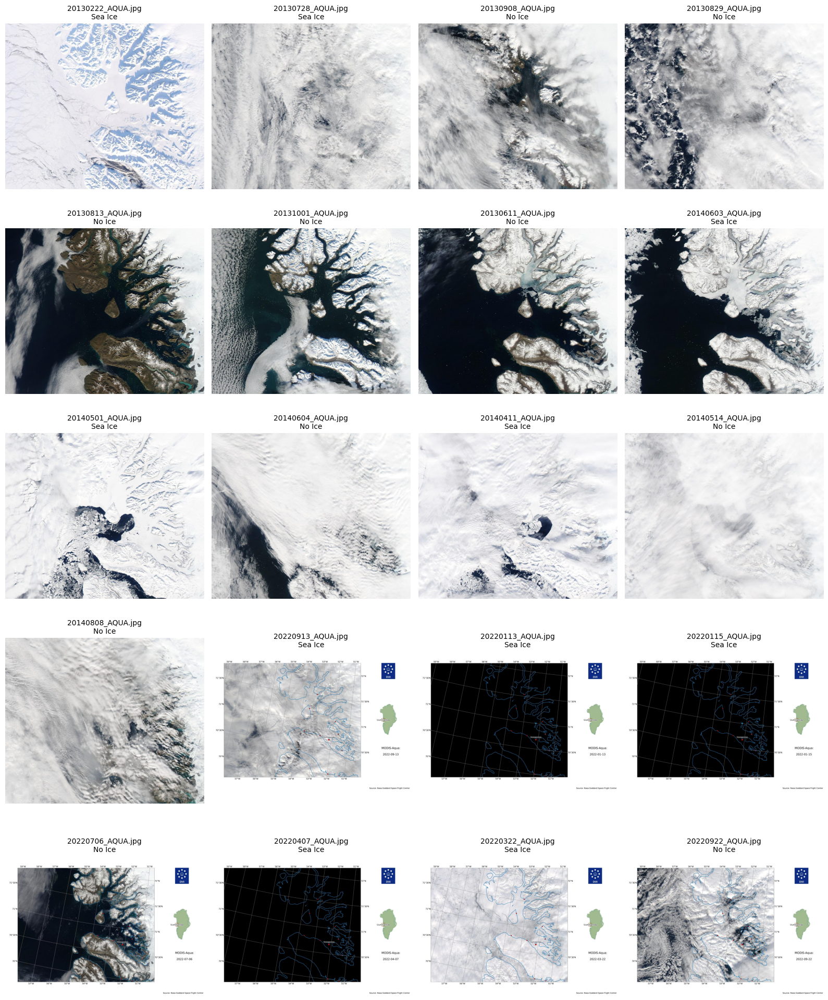

In [23]:
# ==============================
# Inference Cell – Use Saved Model(s)
# ==============================

import os
import glob
import tensorflow as tf
import matplotlib.pyplot as plt
from PIL import Image

# -------------------------------------------------------------------------
# 1) Load the saved models (assumes they are saved as .keras files)
# -------------------------------------------------------------------------
cloud_model = tf.keras.models.load_model("backup_best_cloud_model.keras")
ice_model = tf.keras.models.load_model("backup_best_ice_model.keras")

print("Models loaded successfully.")

# -------------------------------------------------------------------------
# 2) Compute homography parameters (using our reference images)
# -------------------------------------------------------------------------
H, (new_w, new_h) = compute_ref_homography(OLD_REF_PATH, NEW_REF_PATH)
print(f"Computed homography. New reference dimensions: {new_w}x{new_h}")

# -------------------------------------------------------------------------
# 3) Create a list of image paths for inference.
#     Assume that all images are stored in subfolders of `/data/satellite/aqua/`
#     (e.g., folders named "2010", "2011", ..., "2025").
# -------------------------------------------------------------------------
image_paths = glob.glob(os.path.join("data/satellite/aqua", "*", "*.jpg"), recursive=True)
image_paths.extend(glob.glob(os.path.join("data/satellite/aqua", "*", "*.png"), recursive=True))
print(f"Found {len(image_paths)} images in the satellite folder.")

# -------------------------------------------------------------------------
# 4) Define an inference function that uses our pipeline function classify_new_image.
#     This function first uses the cloud model. If the prediction for cloud is 1,
#     it assigns "Cloudy"; otherwise, it uses the ice model to decide between "Sea Ice" and "No Ice".
# -------------------------------------------------------------------------
def infer_image(image_path):
    cloud_lbl = classify_new_image(image_path, H, new_w, new_h, cloud_model, water_mask=None, apply_mask=False)
    if cloud_lbl == 1:
        prediction = "Cloudy"
    else:
        ice_lbl = classify_new_image(image_path, H, new_w, new_h, ice_model, water_mask=None, apply_mask=False)
        prediction = "Sea Ice" if ice_lbl == 0 else "No Ice"
    return prediction

# # -------------------------------------------------------------------------
# # 5) Run inference on a sample of images (e.g., first 5 images) and print the results.
# # -------------------------------------------------------------------------
# print("\n=== Inference Results on Sample Images ===")
# sample_images = image_paths[::20][:25]
# for img_path in sample_images:
#     pred = infer_image(img_path)
#     print(f"Image: {img_path}\n  => Prediction: {pred}\n")
#     # Optionally, display the image:
#     img = Image.open(img_path).convert("RGB")
#     plt.figure()
#     plt.imshow(img)
#     plt.title(f"Prediction: {pred}")
#     plt.axis("off")
#     plt.show()

# ==============================
# Inference Visualization Grid
# ==============================

import math

# Sample 25 images evenly across the dataset
sample_images = image_paths[::max(1, len(image_paths)//100)][:20]

# Run inference and store results
results = []
for img_path in sample_images:
    pred = infer_image(img_path)
    results.append((img_path, pred))

# Plot settings
num_images = len(results)
cols = 4
rows = math.ceil(num_images / cols)

plt.figure(figsize=(4 * cols, 4 * rows))

for idx, (img_path, pred) in enumerate(results):
    img = Image.open(img_path).convert("RGB")
    plt.subplot(rows, cols, idx + 1)
    plt.imshow(img)
    plt.title(f"{os.path.basename(img_path)}\n{pred}", fontsize=10)
    plt.axis("off")

plt.tight_layout()
plt.show()



Found 4339 images in the satellite folder.
Sampling 100 images for inference.
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━

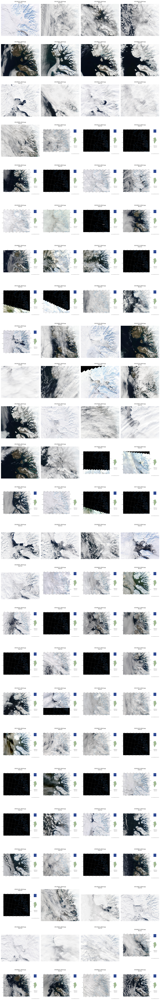

In [25]:
# ==============================
# Inference Visualization Grid for 100 Images
# ==============================

import math
from collections import Counter
import matplotlib.pyplot as plt
from PIL import Image
import glob
import os

# -------------------------------------------------------------------------
# 1) Create a list of image paths for inference.
#     (Assumes images are stored in subfolders of '/data/satellite/aqua/' 
#      e.g., folder names "2010", "2011", ..., "2025".)
# -------------------------------------------------------------------------
image_paths = glob.glob(os.path.join("data/satellite/aqua", "*", "*.jpg"), recursive=True)
image_paths.extend(glob.glob(os.path.join("data/satellite/aqua", "*", "*.png"), recursive=True))
print(f"Found {len(image_paths)} images in the satellite folder.")

# -------------------------------------------------------------------------
# 2) Sample 100 images evenly across the dataset.
# -------------------------------------------------------------------------
num_samples = 100
sample_images = image_paths[::max(1, len(image_paths) // num_samples)][:num_samples]
print(f"Sampling {len(sample_images)} images for inference.")

# -------------------------------------------------------------------------
# 3) Run inference on each sampled image and store results.
#    (infer_image() should be defined in your pipeline and use your loaded models.)
# -------------------------------------------------------------------------
results = []
for img_path in sample_images:
    pred = infer_image(img_path)
    results.append((img_path, pred))

# Display a summary of prediction counts:
pred_counts = Counter(pred for _, pred in results)
print("\nPrediction Distribution:")
for label, count in pred_counts.items():
    print(f"  {label}: {count}")

# -------------------------------------------------------------------------
# 4) Plot the sampled images in a grid, 4 per row.
# -------------------------------------------------------------------------
cols = 4
rows = math.ceil(len(results) / cols)
plt.figure(figsize=(4 * cols, 4 * rows))

for idx, (img_path, pred) in enumerate(results):
    img = Image.open(img_path).convert("RGB")
    plt.subplot(rows, cols, idx + 1)
    plt.imshow(img)
    plt.title(f"{os.path.basename(img_path)}\n{pred}", fontsize=8)
    plt.axis("off")

plt.tight_layout()
plt.show()
